<img style="float: left; margin: 30px 15px 15px 15px;" src="https://pngimage.net/wp-content/uploads/2018/06/logo-iteso-png-5.png" width="300" height="500" /> 
    
    
### <font color='navy'> Simulación de procesos financieros. 

**Nombres:** Carolina Flores Luelmo y Frida María Hernandez López.

**Fecha:** 23 de noviembre del 2021.
    
**Expediente** : Carolina: 713578. Frida: 720476.
    
**Profesor:** Oscar David Jaramillo Zuluaga.

**Liga GitHub:** https://github.com/FridaHernandezL/Tarea8_CFlores_FHernandez

# Tarea 8. Clase 22

1. Replicar el procedimiento anterior para valoración de opciones 'call', pero en este caso para opciones tipo 'put'.
2. Además deben de comparar con los resultados teoricos del método de valuación de Black-Scholes (ecuación del principio de clase)

#### Código de solución `ESTUDIANTE 1: CAROLINA FLORES`

In [1]:
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
#import pandas_datareader.data as web
import scipy.stats as st
import seaborn as sns
import yfinance as yf 
pd.set_option('display.notebook_repr_html', True)
pd.set_option('display.max_columns', 6)
pd.set_option('display.max_rows', 10)
pd.set_option('display.width', 78)
pd.set_option('precision', 3)

In [2]:
def options_yf(ticker : 'MSFT'):
    """
    options_yf descarga información de opciones financieras con ayuda de yfinance
    
    *ticker : es el símbolo de cotización de la acción
    """
    stock = yf.Ticker('MSFT')
    calls, puts = stock.option_chain(stock.options[0]) 
    return calls, puts

 

c, p = options_yf('MSFT')

In [3]:
pd.options.display.max_columns = None

In [4]:
pd.options.display.max_rows = None

In [5]:

p.head()

,contractSymbol,lastTradeDate,strike,lastPrice,bid,ask,change,percentChange,volume,openInterest,impliedVolatility,inTheMoney,contractSize,currency
0,MSFT211126P00150000,2021-11-19 18:59:23,150.0,0.01,0.0,0.01,0.00,0.000,10.0,20,2.625,False,REGULAR,USD
1,MSFT211126P00155000,2021-10-12 15:08:18,155.0,0.07,0.0,0.06,0.00,0.000,NaN,70,2.938,False,REGULAR,USD
2,MSFT211126P00180000,2021-11-23 20:11:46,180.0,0.02,0.0,0.05,-0.01,-33.333,8.0,8,2.359,False,REGULAR,USD
3,MSFT211126P00190000,2021-10-22 16:00:56,190.0,0.04,0.0,0.00,0.00,0.000,2.0,0,0.500,False,REGULAR,USD
4,MSFT211126P00195000,2021-10-26 14:01:32,195.0,0.05,0.0,0.06,0.00,0.000,1.0,5,2.109,False,REGULAR,USD


In [6]:
lastTradeDate = p.iloc[:, 1]
lastPrice = p.iloc[:, 3]
lastTradeDate

0    2021-11-19 18:59:23
1    2021-10-12 15:08:18
2    2021-11-23 20:11:46
3    2021-10-22 16:00:56
4    2021-10-26 14:01:32
5    2021-10-18 16:11:27
6    2021-10-08 15:45:41
7    2021-11-22 17:52:50
8    2021-10-27 13:33:32
9    2021-10-21 19:58:53
10   2021-11-16 14:37:42
11   2021-11-23 15:55:17
12   2021-11-22 14:39:43
13   2021-11-12 15:08:31
14   2021-11-23 15:47:55
15   2021-11-17 18:26:58
16   2021-11-19 19:16:25
17   2021-11-23 16:20:17
18   2021-11-22 18:35:17
19   2021-11-23 15:46:26
20   2021-11-23 18:44:20
21   2021-11-23 16:31:58
22   2021-11-23 20:55:03
23   2021-11-23 20:58:54
24   2021-11-23 20:59:36
25   2021-11-23 19:20:09
26   2021-11-23 20:59:46
27   2021-11-23 20:59:46
28   2021-11-23 20:46:34
29   2021-11-23 20:53:34
30   2021-11-23 20:58:29
31   2021-11-23 20:59:17
32   2021-11-23 20:55:03
33   2021-11-23 20:59:22
34   2021-11-23 20:59:05
35   2021-11-23 20:59:22
36   2021-11-23 20:59:02
37   2021-11-23 21:00:00
38   2021-11-23 20:59:34
39   2021-11-23 20:58:28


In [7]:
fecha1 = '2020-06-19'
fecha2 = '2021-01-15'

put06_f1 = p.loc[(lastTradeDate== fecha1) ]
put06_f2 = p.loc[(lastTradeDate== fecha2) ]

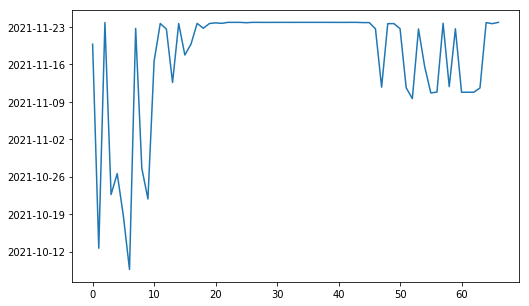

In [8]:
lastTradeDate.plot(figsize=(8,5))

In [9]:
#Precio del activo subyacente
msft_price = 339 #dato visto en yahoo 
p.iloc[57,2] 

420.0

In [10]:
data = pd.read_csv('MSFT.csv')
data=data.set_index('Date')
closes_msft=pd.DataFrame(data['Adj Close'])
closes_msft.head()

,Adj Close
Date,
<<<<<<< Updated upstream,NaN
2017-01-03,58.186
2017-01-04,57.925
2017-01-05,57.925
2017-01-06,58.427


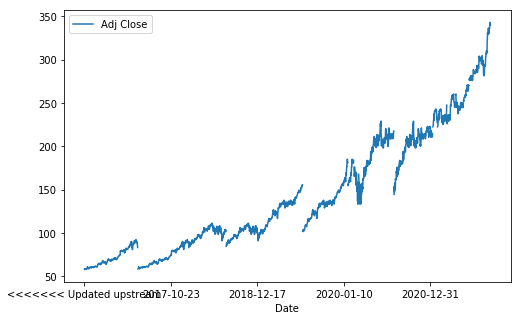

In [11]:
closes_msft.plot(figsize=(8,5))

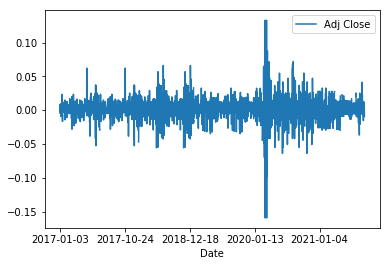

In [12]:
def calc_daily_ret(closes):
    return np.log(closes/closes.shift(1)).iloc[1:]

ret_msft = calc_daily_ret(closes_msft)
ret_msft.plot()
plt.show()

In [13]:
msft_price = 337.68 # strike price
indice_opt = p.iloc[57,:]
df = pd.DataFrame(indice_opt)
df

,57
contractSymbol,MSFT211126P00420000
lastTradeDate,2021-11-23 16:45:15
strike,420
lastPrice,84.8
bid,80.8
ask,83.7
change,0.35
percentChange,0.414
volume,1
openInterest,0


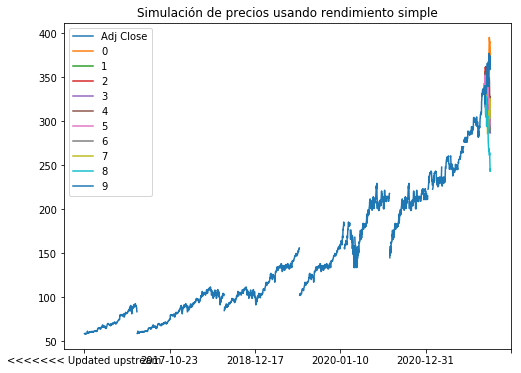

In [14]:
from datetime import date
Ri = closes_msft.pct_change(1).iloc[1:]
mu_R = Ri.mean()[0]
sigma_R = Ri.std()[0]

today = pd.Timestamp(date.today())
expiry = 2021-12-26
ndays = 33
nscen = 1000
dates = pd.date_range(start = today, periods = ndays)

dt = 1
Z = np.random.randn(ndays,nscen)
# Simulación normal de los rendimientos
Ri_dt = pd.DataFrame(mu_R*dt+Z*sigma_R*np.sqrt(dt),index=dates)
Ri_dt.cumprod()

# Simulación del precio
S_0 = closes_msft.iloc[-1,0]
S_T = S_0*(1+Ri_dt).cumprod()
S_T.iloc[0,:] = S_0

# Se muestran los precios simulados con los precios descargados
pd.concat([closes_msft, S_T.iloc[:, :10]]).plot(figsize=(8,6));
plt.title('Simulación de precios usando rendimiento simple');

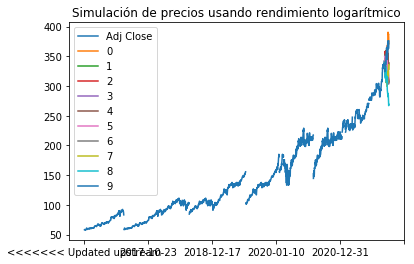

In [15]:
#Rendimiento logaritmico
ri = calc_daily_ret(closes_msft)
mu_r = ri.mean()[0]
sigma_r = ri.std()[0]

sim_ret_ri = pd.DataFrame(mu_r*dt+Z*sigma_r*np.sqrt(dt), index=dates)

# Simulación del precio
S_0 = closes_msft.iloc[-1,0]
S_T2 = S_0*np.exp(sim_ret_ri.cumsum())

# Se muestran los precios simulados con los precios descargados
pd.concat([closes_msft,S_T2.iloc[:, :10]]).plot()
plt.title('Simulación de precios usando rendimiento logarítmico')
plt.show()

In [16]:
e1 = np.abs(S_T-S_T2).mean().mean()
e1

5.557952840051961

Con los precios simulados debemos de encontrar el valor de la opción según la función de pago

In [17]:
mu = ret_msft.mean()[0]
sigma = ret_msft.std()[0]
mu, sigma

(0.001345395246618935, 0.017212492061457512)

In [18]:
r = 0.0021/252 # Tasa diaria

In [19]:
#Simulando 10 escenarios hata fecha de expiry
from datetime import date

today = pd.Timestamp(date.today())
expiry =pd.to_datetime('2021-12-26')

nscen = 10
dates = pd.date_range(start='2021-04-28', periods = ndays)
#len(dates)

#Rendimientos simulados
sim_ret = pd.DataFrame(sigma*np.random.randn(ndays,nscen)+r, index=dates)
sim_ret.cumsum()

,0,1,2,3,4,5,6,7,8,9
2021-04-28,-2.607e-03,-0.017,-0.010,-0.008,0.022,-0.019,-0.013,-0.005,0.019,-1.020e-02
2021-04-29,-2.129e-02,-0.010,-0.003,0.013,0.023,0.004,-0.033,0.013,0.044,-2.426e-02
2021-04-30,6.243e-03,-0.020,-0.016,0.010,0.008,0.015,-0.035,0.026,0.057,-1.143e-02
2021-05-01,-9.190e-04,-0.051,-0.005,-0.013,0.023,0.005,-0.049,0.023,0.067,1.730e-02
2021-05-02,3.350e-03,-0.059,0.024,-0.024,0.042,0.023,-0.027,-0.021,0.075,1.558e-02
2021-05-03,-3.448e-03,-0.062,0.067,-0.006,0.037,0.023,-0.023,0.022,0.058,2.485e-02
2021-05-04,-2.857e-02,-0.076,0.076,-0.020,0.036,0.006,-0.050,0.020,0.060,4.224e-02
2021-05-05,-4.168e-02,-0.100,0.066,-0.040,0.035,0.004,-0.079,-0.006,0.053,3.938e-02
2021-05-06,-5.430e-02,-0.114,0.077,-0.016,0.009,-0.024,-0.092,-0.019,0.059,4.724e-02
2021-05-07,-4.784e-02,-0.073,0.063,-0.045,0.001,-0.014,-0.093,-0.048,0.057,3.302e-02


In [20]:
S0 = closes_msft.iloc[-1,0]  # Condición inicial del precio a simular
sim_closes = S0*np.exp(sim_ret.cumsum())
sim_closes.iloc[0, :] = S0
sim_closes.head()

,0,1,2,3,4,5,6,7,8,9
2021-04-28,339.830,339.830,339.830,339.830,339.830,339.830,339.830,339.830,339.830,339.830
2021-04-29,332.673,336.452,338.877,344.178,347.793,341.200,328.711,344.284,355.228,331.684
2021-04-30,341.958,333.251,334.525,343.281,342.623,344.966,328.181,348.850,359.622,335.966
2021-05-01,339.518,323.064,338.210,335.289,347.815,341.376,323.634,347.608,363.540,345.761
2021-05-02,340.970,320.359,348.255,331.862,354.582,347.583,330.631,332.814,366.381,345.166


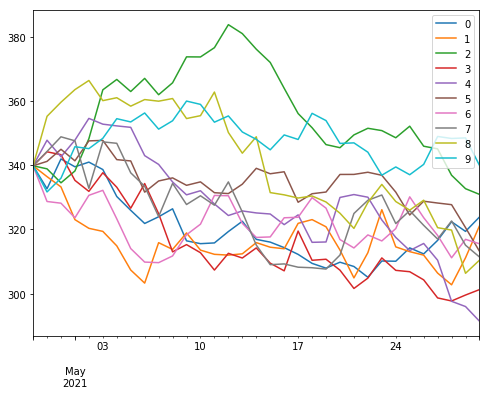

In [21]:
sim_closes.plot(figsize=(8,6));

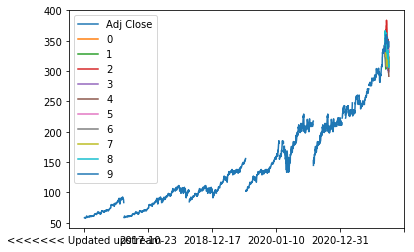

In [22]:
pd.concat([closes_msft,sim_closes]).plot()
plt.show()

In [23]:
from datetime import date

Hoy = date.today()
K =  338  # strike price
nscen = 100000
dates = pd.date_range(start= Hoy, periods = ndays)
ndays = len(dates)
S0 = closes_msft.iloc[-1,0]  # Condición inicial del precio a simular

sim_ret = pd.DataFrame(sigma*np.random.randn(ndays,nscen)+r,index=dates)
sim_closes = S0*np.exp(sim_ret.cumsum())

sim_closes.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

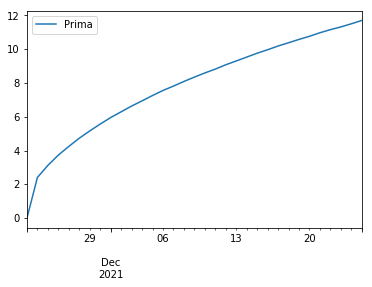

In [24]:
sim_closes.iloc[0, :] = closes_msft.iloc[-1]
strike = 338
put = pd.DataFrame({'Prima':np.exp(-r*ndays) \
              *np.fmax(strike-sim_closes, 0).mean(axis=1)}, index=dates)
put.plot();

In [25]:
put.iloc[-1]
confianza = 0.99
sigma_est = sim_closes.iloc[-1].sem()
mean_est = put.iloc[-1].Prima
i1 = st.t.interval(confianza,nscen-1, loc=mean_est, scale=sigma_est)
i2 = st.norm.interval(confianza, loc=mean_est, scale=sigma_est)
print(i1)
print(i2)

(11.426416179278482, 11.977458917467215)
(11.426421438268102, 11.977453658477595)


In [26]:
put.iloc[-1]

Prima    11.702
Name: 2021-12-25 00:00:00, dtype: float64

El precio de la opción es de 12.094

#### Código de solución `ESTUDIANTE 2: FRIDA HERNÁNDEZ`

## Punto 1.

#### Simulación de precios usando rendimiento simple y logarítmico 

In [27]:
#importar los paquetes que se van a usar
import pandas as pd
import pandas_datareader.data as web
import numpy as np
import datetime
import matplotlib.pyplot as plt
import scipy.stats as st
import seaborn as sns
%matplotlib inline
#algunas opciones para Pandas
pd.set_option('display.notebook_repr_html', True)
pd.set_option('display.max_columns', 6)
pd.set_option('display.max_rows', 10)
pd.set_option('display.width', 78)
pd.set_option('precision', 3)

ImportError: cannot import name 'urlencode'

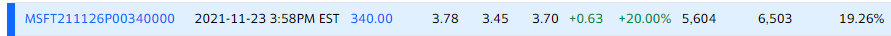

Me quiero acercar a un valor de 3.78

In [ ]:
data = pd.read_csv('MSFT.csv')
data=data.set_index('Date')
closes=pd.DataFrame(data.iloc[:,4])
closes

* Comenzaremos por suponer que los rendimientos son un p.e. estacionario que distribuyen $\mathcal{N}(\mu,\sigma)$.

In [ ]:
# Obtenemos el rendimiento simple
Ri = closes.pct_change(1).iloc[1:]
# Obtenemos su media y desviación estándar de los rendimientos
mu_R = Ri.mean()[0]
sigma_R = Ri.std()[0]
Ri.head()

In [ ]:
from datetime import date

today = pd.Timestamp(date.today())
expiry = '2021-11-26'

nscen = 1000
dates = pd.date_range(start=today, end=expiry, freq='B')
ndays = len(dates)

#### Mostrar como simular precios usando los rendimientos

In [ ]:
dt = 1; # Rendimiento diario 
Z = np.random.randn(ndays,nscen)  # Z ~ N(0,1)
# Simulación normal de los rendimientos
Ri_dt = pd.DataFrame(mu_R*dt+Z*sigma_R*np.sqrt(dt),index=dates)
Ri_dt.cumprod()

In [ ]:
# Simulación del precio
S_0 = closes.iloc[-1,0]
S_T = S_0*(1+Ri_dt).cumprod()

# Se muestran los precios simulados con los precios descargados
# pd.concat([closes_aapl,S_T]).plot(figsize=(8,6));
# plt.title('Simulación de precios usando rendimiento simple');

#### Rendimiento Logarítmico

In [ ]:
def calc_daily_ret(closes):
    return np.log(closes/closes.shift(1)).iloc[1:]

ri = calc_daily_ret(closes)
# Usando la media y desviación estándar de los rendimientos logarítmicos
mu_r = ri.mean()[0]
sigma_r = ri.std()[0]

# # Usando la equivalencia teórica
# mu_r2 = mu_R - (sigma_R**2)/2

sim_ret_ri = pd.DataFrame(mu_r*dt+Z*sigma_r*np.sqrt(dt), index=dates)

# Simulación del precio
S_0 = closes.iloc[-1,0]
S_T2 = S_0*np.exp(sim_ret_ri.cumsum())

# Se muestran los precios simulados con los precios descargados
# pd.concat([closes_aapl,S_T2]).plot(figsize=(8,6));
# plt.title('Simulación de precios usando rendimiento logarítmico');

# from sklearn.metrics import mean_absolute_error
e1 = np.abs(S_T-S_T2).mean().mean()
e1

In [ ]:
S_T2.iloc[0, :] = closes.iloc[-1]
S_T2

In [ ]:
print('Las std usando rendimientos logarítmicos y simples son similares')
sigma_R,sigma_r

Con los precios simulados debemos de encontrar el valor de la opción según la función de pago correspondiente. Para este caso es:
$$
max(K - S_T,0)
$$

In [ ]:
strike = 340
put = pd.DataFrame({'Prima':np.exp(-mu_r*ndays) \
              *np.fmax(strike-S_T2, 0).mean(axis=1)}, index=dates)
put.plot();
put.iloc[-1]

#### 2. Valuación usando simulación: modelo normal para los rendimientos

- Hallar media y desviación estándar muestral de los rendimientos logarítmicos

In [ ]:
ret = calc_daily_ret(closes)
ret.plot(figsize=(8,6));

In [ ]:
mu = ret.mean()[0]
sigma = ret.std()[0]
mu, sigma

No se toma la media sino la tasa libre de riesgo
> Referencia: https://www.treasury.gov/resource-center/data-chart-center/interest-rates/Pages/TextView.aspx?data=yield

In [ ]:
# Tasa de bonos de 1 yr de fecha 11/23/21
r = 0.0021/360 # Tasa diaria

- Simularemos el tiempo de contrato desde `HOY` hasta la fecha de `Expiry`, 10 escenarios:
    
    - Generar fechas

In [ ]:
from datetime import date

today = pd.Timestamp(date.today())
expiry =expiry

dates = pd.date_range(start=today, end = expiry, freq='B')
ndays = len(dates)

In [ ]:
sim_ret = pd.DataFrame(sigma*np.random.randn(ndays,nscen)+r, index=dates)
sim_ret.cumsum()
# Las columnas son los escenarios y las filas son las días de contrato

- Con los rendimientos simulados, calcular los escenarios de precios respectivos:

In [ ]:
S0 = closes.iloc[-1,0]  # Condición inicial del precio a simular
sim_closes = S0*np.exp(sim_ret.cumsum())
sim_closes

- Graficar:

In [ ]:
sim_closes.plot(figsize=(8,6));

In [ ]:
# Se muestran los precios simulados con los precios descargados
pd.concat([closes,sim_closes]).plot(figsize=(8,6));

In [ ]:
from datetime import date
Hoy = date.today()
K = 340 # strike price
nscen = 1000
dates = pd.date_range(start= Hoy, periods = ndays)
ndays = len(dates)
S0 = closes.iloc[-1,0]  # Condición inicial del precio a simular

sim_ret = pd.DataFrame(sigma*np.random.randn(ndays,nscen)+r,index=dates)
sim_closes = S0*np.exp(sim_ret.cumsum())
#strike = pd.DataFrame({'Strike':K*np.ones(ndays)}, index=dates)
#simul = pd.concat([closes_aapl.T,strike.T,sim_closes.T]).T
#simul.plot(figsize=(8,6),legend=False);
sim_closes

In [ ]:
sim_closes.iloc[0, :] = closes.iloc[-1]
sim_closes

In [ ]:
strike = 340
put = pd.DataFrame({'Prima':np.exp(-r*ndays) \
              *np.fmax(strike-sim_closes, 0).mean(axis=1)}, index=dates)
put.plot();

La valuación de la opción es:

In [ ]:
put.iloc[-1]

Intervalo de confianza del 99%

In [ ]:
confianza = 0.99
sigma_est = sim_closes.iloc[-1].sem()
mean_est = put.iloc[-1].Prima
i1 = st.t.interval(confianza,nscen-1, loc=mean_est, scale=sigma_est)
i2 = st.norm.interval(confianza, loc=mean_est, scale=sigma_est)
print(i1)
print(i2)

#### Precios simulados usando técnicas de reducción de varianza

In [ ]:
# Usando muestreo estratificado----> #estratros = nscen
U = (np.arange(0,nscen)+np.random.rand(ndays,nscen))/nscen
Z = st.norm.ppf(U)

sim_ret2 = pd.DataFrame(sigma*Z+r,index=dates)
sim_closes2 = S0*np.exp(sim_ret.cumsum())

# Función de pago
strike = pd.DataFrame(K*np.ones([ndays,nscen]), index=dates)
put = pd.DataFrame({'Prima':np.exp(-r*ndays) \
              *np.fmax(strike-sim_closes2,np.zeros([ndays,nscen])).T.mean()}, index=dates)
put.plot();

La valuación de la opción es:

In [ ]:
put.iloc[-1]

Intervalo de confianza del 99%

In [ ]:
confianza = 0.99
sigma_est = sim_closes2.iloc[-1].sem()
mean_est = put.iloc[-1].Prima
i1 = st.t.interval(confianza,nscen-1, loc=mean_est, scale=sigma_est)
i2 = st.norm.interval(confianza, loc=mean_est, scale=sigma_est)
print(i1)
print(i1)

#### Análisis de la distribución de los rendimientos

#### Ajustando norm

In [ ]:
ren = calc_daily_ret(closes) # rendimientos 
y,x,des = plt.hist(ren['Adj Close'],bins=50,density=True,label='Histograma rendimientos')

mu_fit,sd_fit = st.norm.fit(ren) # Se ajustan0 los parámetros de una normal
# Valores máximo y mínimo de los rendiemientos a generar
ren_max = max(x);ren_min = min(x)
# Vector de rendimientos generados
ren_gen = np.arange(ren_min,ren_max,0.001)
# Generación de la normal ajustado con los parámetros encontrados
curve_fit = st.norm.pdf(ren_gen,loc=mu_fit,scale=sd_fit)
plt.plot(ren_gen,curve_fit,label='Distribución ajustada')
plt.legend()
plt.show()

#### Ajustando t

In [ ]:
ren = calc_daily_ret(closes) # rendimientos 
y,x,des = plt.hist(ren['Adj Close'],bins=50,density=True,label='Histograma rendimientos')

dof,mu_fit,sd_fit = st.t.fit(ren.values) # Se ajustan los parámetros de una normal
# Valores máximo y mínimo de los rendiemientos a generar
# ren_max = max(x);ren_min = min(x)
# Vector de rendimientos generados
ren_gen = np.arange(ren_min,ren_max,0.001)
# Generación de la normal ajustado con los parámetros encontrados
curve_fit = st.t.pdf(ren_gen, df=dof,loc=mu_fit,scale=sd_fit)
plt.plot(ren_gen,curve_fit,label='Distribución ajustada')
plt.legend()
plt.show()### Ajustando t

In [ ]:
st.probplot(ren['Adj Close'],sparams= dof, dist='t', plot=plt);

#### 3. Valuación usando simulación: uso del histograma de rendimientos

Todo el análisis anterior se mantiene. Solo cambia la forma de generar los números aleatorios para la simulación montecarlo.

Ahora, generemos un histograma de los rendimientos diarios para generar valores aleatorios de los rendimientos simulados.

- Primero, cantidad de días y número de escenarios de simulación

In [ ]:
ndays = ndays
nscen = nscen

- Del histograma anterior, ya conocemos las probabilidades de ocurrencia, lo que se llamó como variable `y`

In [ ]:
prob = y/np.sum(y)
values = x[1:]

- Con esto, generamos los números aleatorios correspondientes a los rendimientos (tantos como días por número de escenarios).

In [ ]:
ret = np.random.choice(values, ndays*nscen, p=prob)
dates = pd.date_range(start=Hoy,periods=ndays)
sim_ret_hist = pd.DataFrame(ret.reshape((ndays,nscen)),index=dates)
sim_ret_hist

In [ ]:
sim_closes_hist = (closes.iloc[-1,0])*np.exp(sim_ret_hist.cumsum())
sim_closes_hist

In [ ]:
sim_closes_hist.plot(figsize=(8,6),legend=False);

In [ ]:
pd.concat([closes,sim_closes_hist]).plot(figsize=(8,6),legend=False);
plt.title('Simulación usando el histograma de los rendimientos')

In [ ]:
K=340
freq, values = np.histogram(ret+r-mu, bins=2000)
prob = freq/np.sum(freq)
ret=np.random.choice(values[1:],ndays*nscen,p=prob)
dates=pd.date_range('2021-11-26',periods=ndays)
sim_ret_hist = pd.DataFrame(ret.reshape((ndays,nscen)),index=dates)
sim_closes_hist = (closes.iloc[-1,0])*np.exp(sim_ret_hist.cumsum())

In [ ]:
strike = pd.DataFrame(K*np.ones(ndays*nscen).reshape((ndays,nscen)), index=dates)
put_hist = pd.DataFrame({'Prima':np.exp(-r*ndays)*np.fmax(strike-sim_closes_hist,np.zeros(ndays*nscen).reshape((ndays,nscen))).T.mean()}, index=dates)
put_hist.plot();

In [ ]:
put_hist.iloc[-1]

In [ ]:
confianza = 0.95
sigma_est = sim_closes_hist.iloc[-1].sem()
mean_est = put_hist.iloc[-1].Prima
i1 = st.t.interval(confianza,nscen-1, loc=mean_est, scale=sigma_est)
i2 = st.norm.interval(confianza, loc=mean_est, scale=sigma_est)
print(i1)
print(i1)

## Punto 2.

1. Ecuación de Black-Scholes
$$ dS(t) = \mu S(t) + \sigma S(t)dW_t$$
2. Solución de la ecuación

El valor de una opción Europea de vainilla $V_t$ puede obtenerse por:
$$V_t = F(t,S_t)$$ donde

$$F(t,S_t)=S_tN(d_1)-Ke^{r(t-t)}N(d_2)$$
$$N(x)=\frac{1}{\sqrt(2\pi)}\int^x_{-\inf}e^{-y^2/2}dy$$
$$d1=\frac{ln(S_t/K)+(r+\frac{1}{2}\sigma^2)(T-t)}{\sigma\sqrt(T-t)}$$
$$d2=\frac{ln(S_t/K)+(r-\frac{1}{2}\sigma^2)(T-t)}{\sigma\sqrt(T-t)}$$
$$p=ke^{-rT}N(d2)-S_tN(d1)$$

In [ ]:
S0=339.830
k=340
r=0.0021/360
sigma=0.017
sigma2=sigma*sigma
T=1

d1=(np.log(S0/k)+(r+0.5*sigma2)*(T))/(sigma*np.sqrt(T))
d2=d1-sigma*np.sqrt(T)

from scipy.stats import norm
N1=norm.cdf(d1)
N2=norm.cdf(d2)

p=k*np.exp(-r*T)*N1-S0*N2
p